In [22]:
import torch
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import MNIST, ImageFolder, CIFAR10
from torch.utils.data import DataLoader
from model import Discriminator, Generator, initialize_weights
import matplotlib.pyplot as plt
from utils import gradient_penalty
from tqdm.auto import tqdm

In [23]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
learning_rate = 1e-4
batch_size = 64
image_size = 64
channels_img = 3
z_dim = 100
num_classes = 10
gen_embedding = 100
num_epochs = 10
features_d = 64
features_g = 64
critic_iterations = 5
lambda_gp = 10

transforms = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize([0.5 for _ in range(channels_img)], [0.5 for _ in range(channels_img)])
])

In [24]:
dataset = CIFAR10(root='../WGAN/dataset/', transform=transforms)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [25]:
gen = Generator(z_dim, channels_img, features_g, num_classes, img_size=image_size, embed_size=gen_embedding).to(device)
disc = Discriminator(channels_img, features_d, num_classes, image_size).to(device)
initialize_weights(gen)
initialize_weights(disc)

opt_gen = optim.Adam(gen.parameters(), learning_rate, betas=(0.0, 0.9))
opt_disc = optim.Adam(disc.parameters(), learning_rate, betas=(0.0, 0.9))

fixed_noise = torch.randn(32, z_dim, 1, 1).to(device)

gen.train()
disc.train()

Discriminator(
  (disc): Sequential(
    (0): Conv2d(4, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
  )
  (embed): Embedding(10

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0/10 
 batch: 0/782 
 loss D: 8.154194831848145 loss G: 3.9810879230499268


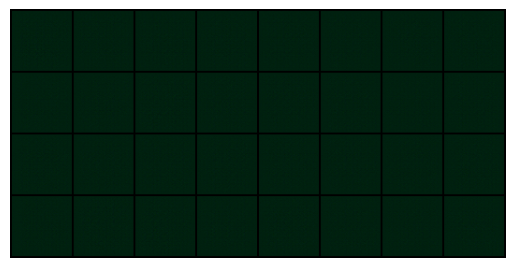

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


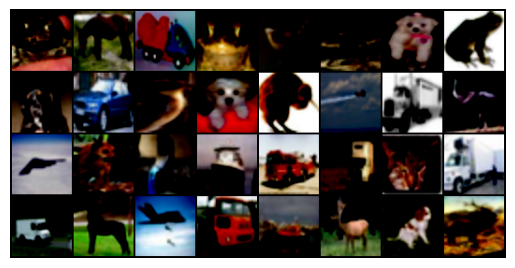

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0/10 
 batch: 100/782 
 loss D: -92.8574447631836 loss G: 125.88496398925781


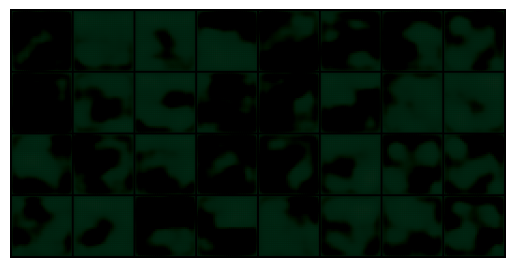

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


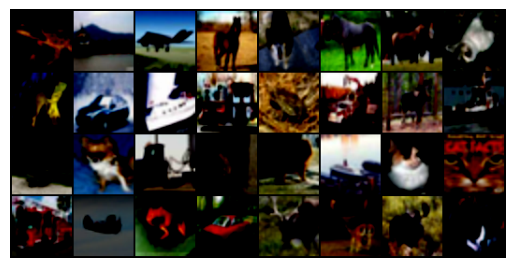

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0/10 
 batch: 200/782 
 loss D: -50.82202911376953 loss G: 144.14080810546875


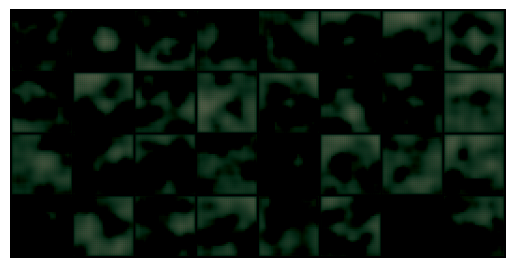

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


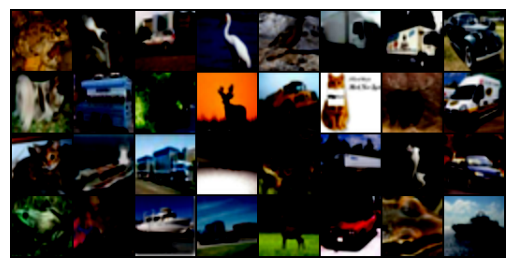

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0/10 
 batch: 300/782 
 loss D: -49.49876403808594 loss G: 141.7293243408203


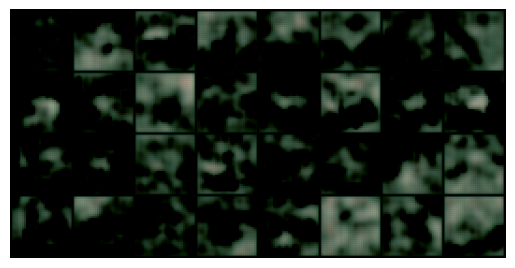

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


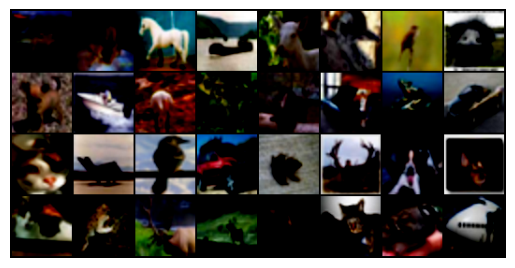

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0/10 
 batch: 400/782 
 loss D: -36.35082244873047 loss G: 145.3485107421875


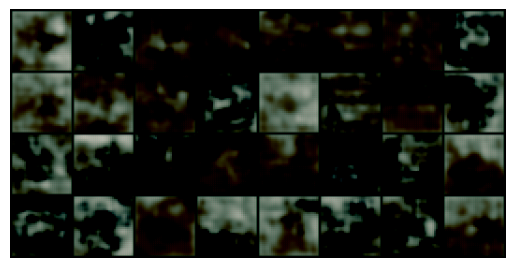

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


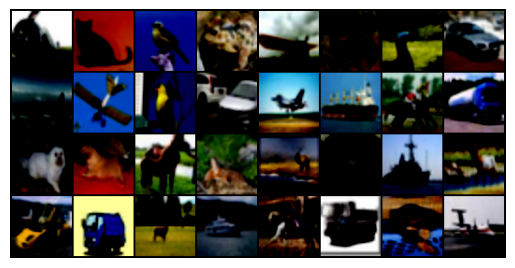

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0/10 
 batch: 500/782 
 loss D: -29.710256576538086 loss G: 134.4654541015625


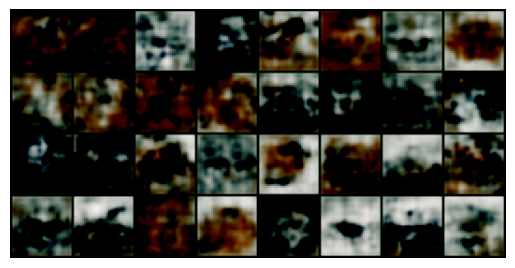

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


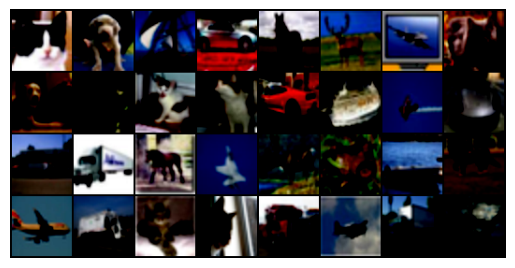

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0/10 
 batch: 600/782 
 loss D: -24.858165740966797 loss G: 137.61578369140625


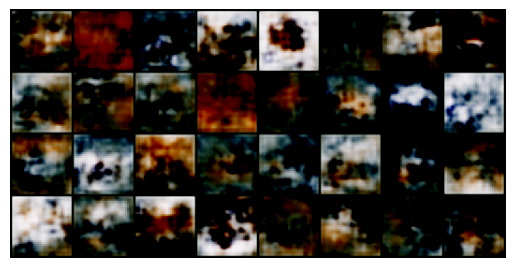

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


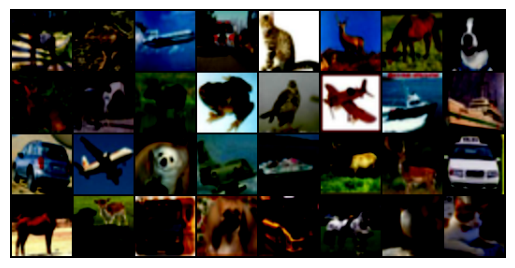

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0/10 
 batch: 700/782 
 loss D: -19.392284393310547 loss G: 129.26943969726562


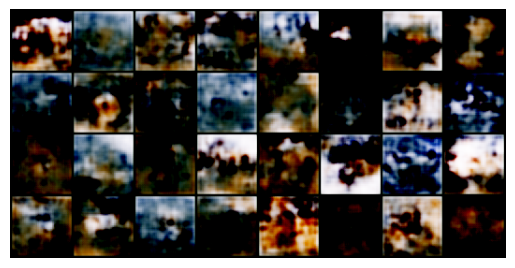

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


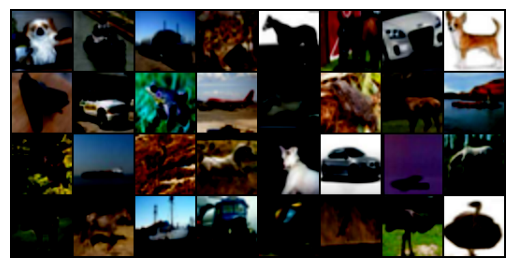

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1/10 
 batch: 0/782 
 loss D: -16.10523223876953 loss G: 136.29605102539062


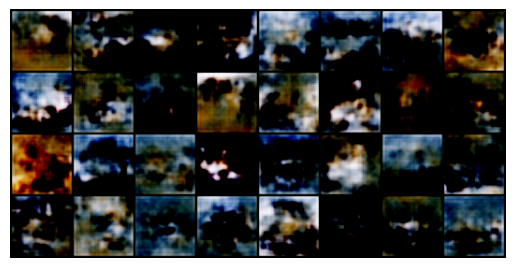

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


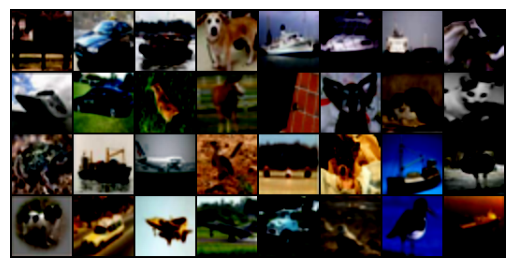

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1/10 
 batch: 100/782 
 loss D: -16.603363037109375 loss G: 137.98683166503906


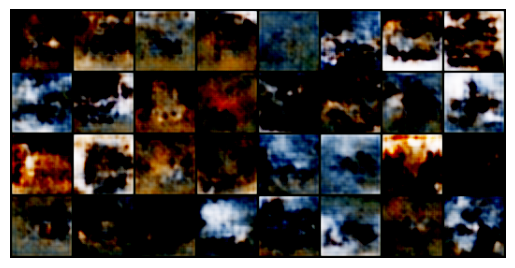

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


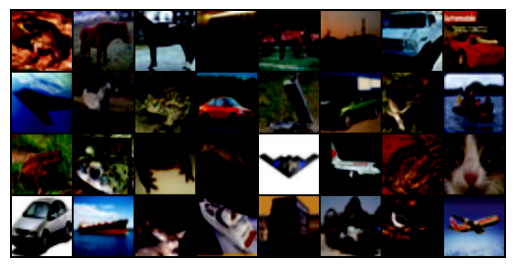

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1/10 
 batch: 200/782 
 loss D: -14.508783340454102 loss G: 140.06356811523438


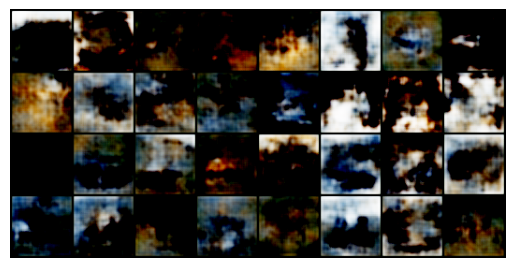

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


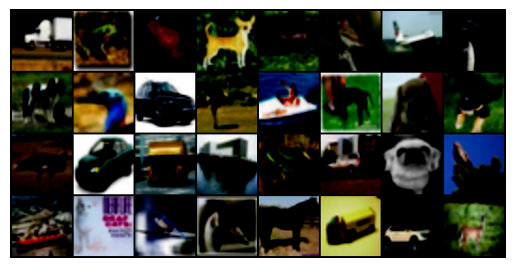

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1/10 
 batch: 300/782 
 loss D: -17.73091697692871 loss G: 128.86573791503906


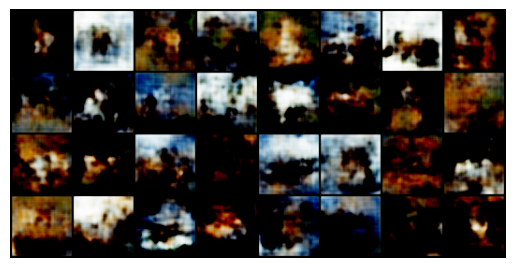

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


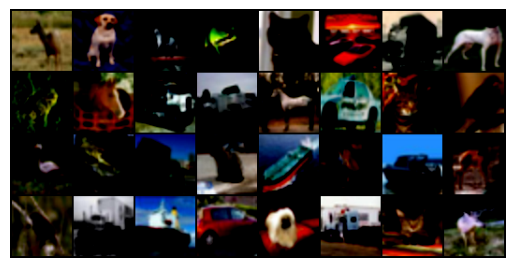

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1/10 
 batch: 400/782 
 loss D: -16.008285522460938 loss G: 152.01870727539062


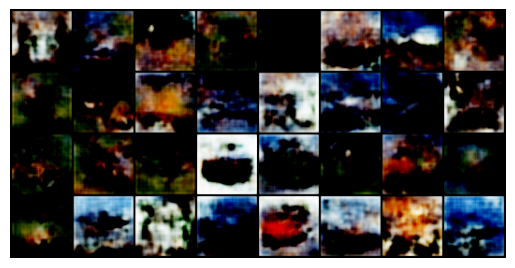

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


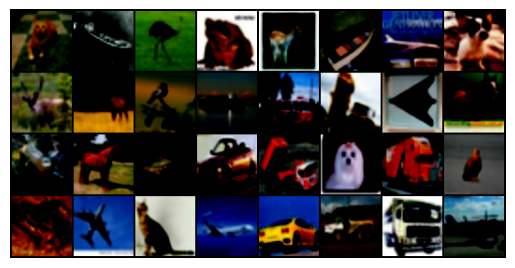

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1/10 
 batch: 500/782 
 loss D: -16.67525291442871 loss G: 127.04951477050781


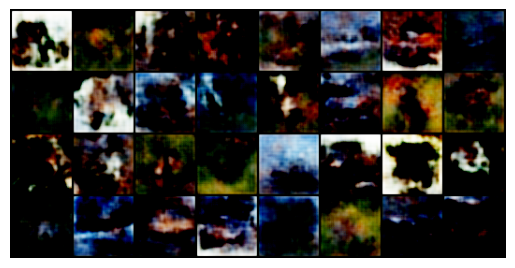

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


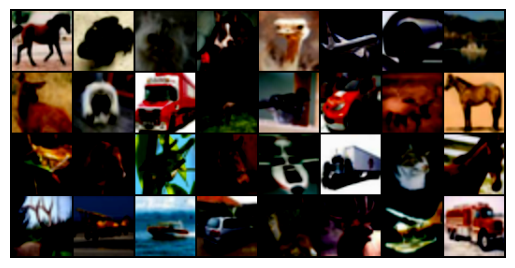

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1/10 
 batch: 600/782 
 loss D: -15.14120864868164 loss G: 141.71047973632812


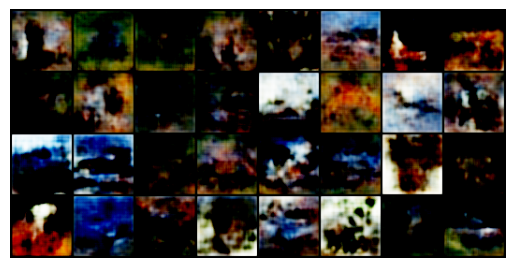

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


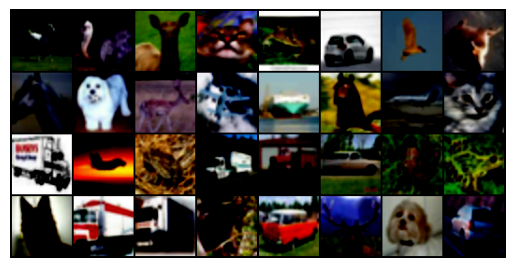

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1/10 
 batch: 700/782 
 loss D: -14.920578002929688 loss G: 135.06832885742188


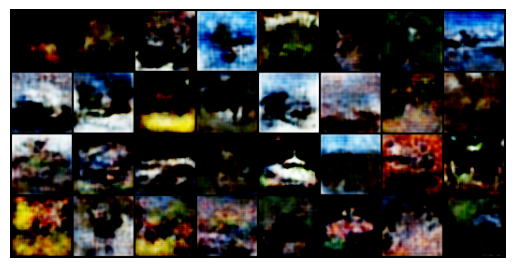

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


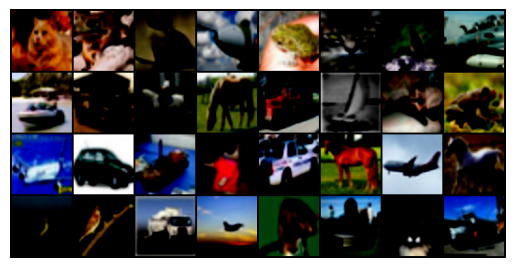

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2/10 
 batch: 0/782 
 loss D: -13.404155731201172 loss G: 138.78152465820312


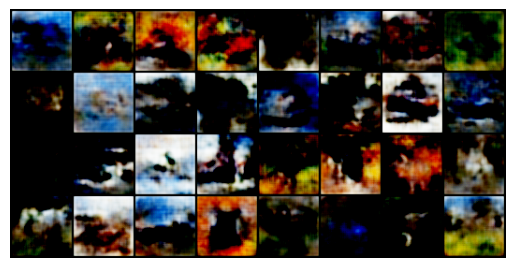

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


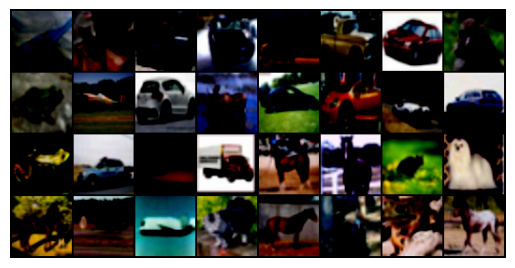

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2/10 
 batch: 100/782 
 loss D: -15.085762023925781 loss G: 139.256103515625


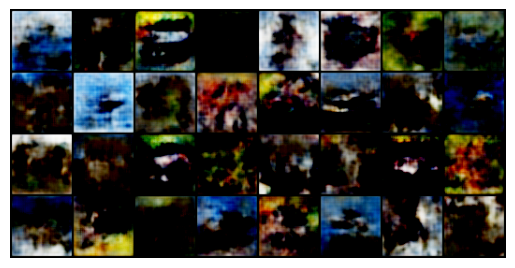

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


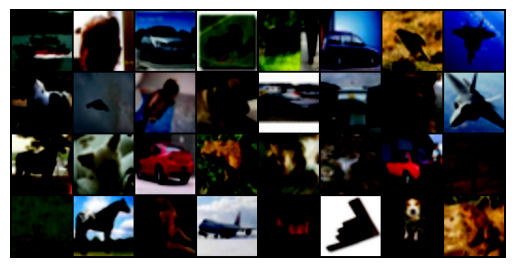

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2/10 
 batch: 200/782 
 loss D: -11.473626136779785 loss G: 142.16665649414062


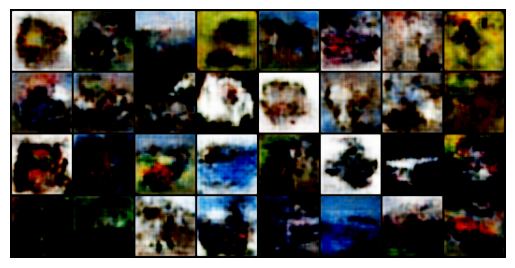

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


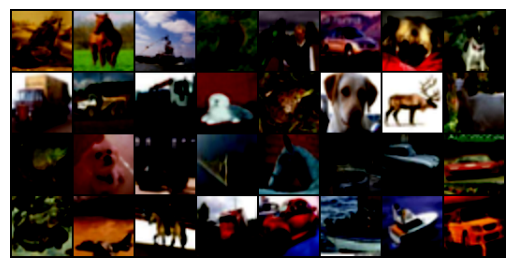

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2/10 
 batch: 300/782 
 loss D: -15.913251876831055 loss G: 155.40428161621094


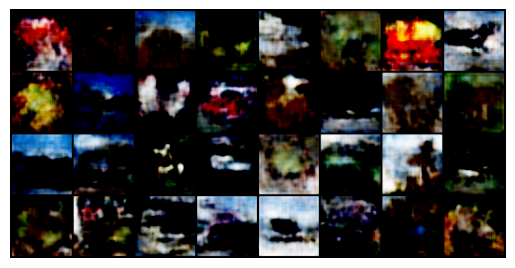

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


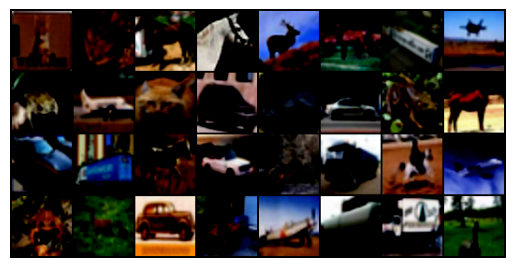

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2/10 
 batch: 400/782 
 loss D: -12.809955596923828 loss G: 151.93365478515625


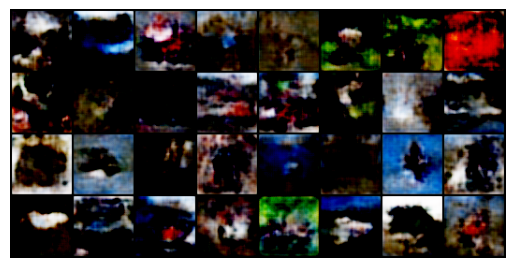

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


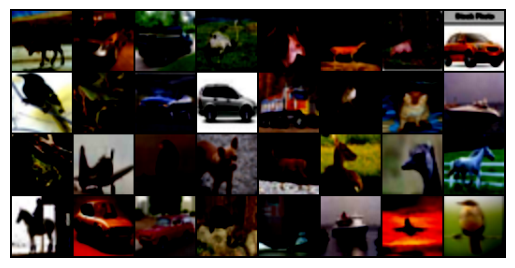

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2/10 
 batch: 500/782 
 loss D: -13.399003982543945 loss G: 141.424560546875


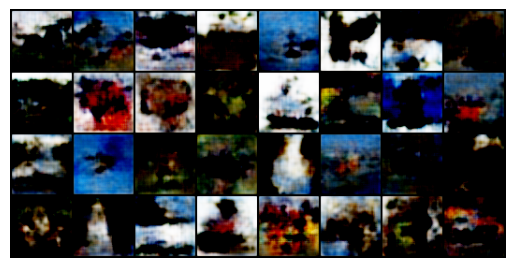

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


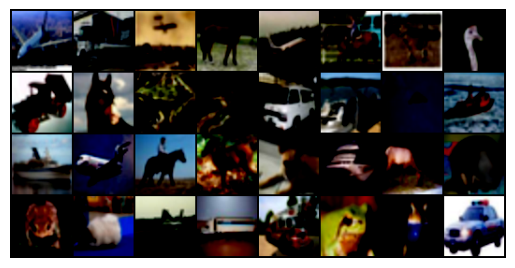

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2/10 
 batch: 600/782 
 loss D: -15.403393745422363 loss G: 149.84164428710938


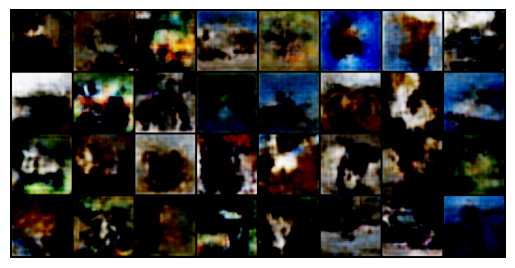

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


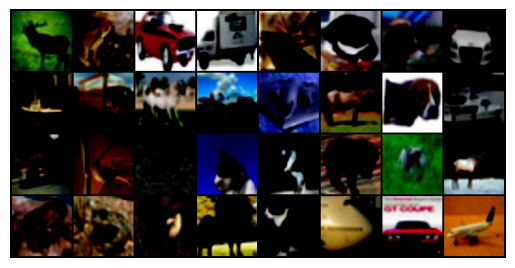

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2/10 
 batch: 700/782 
 loss D: -15.455068588256836 loss G: 160.53494262695312


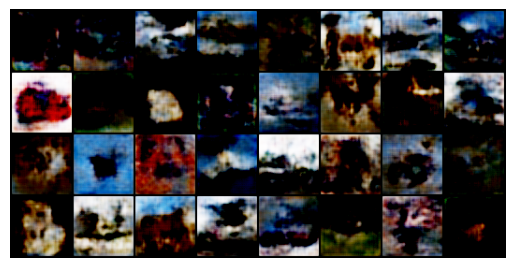

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


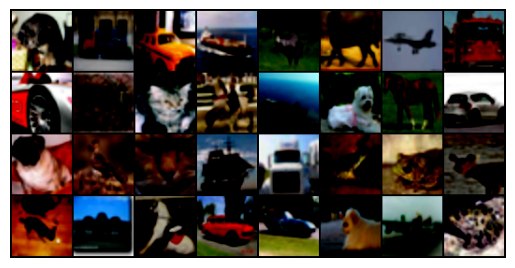

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3/10 
 batch: 0/782 
 loss D: -12.744658470153809 loss G: 155.4517822265625


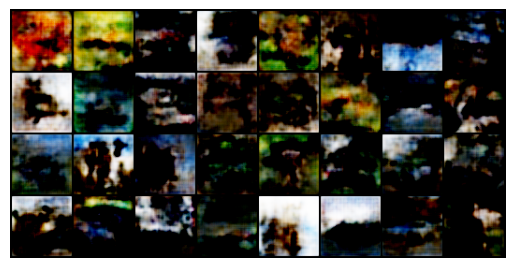

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


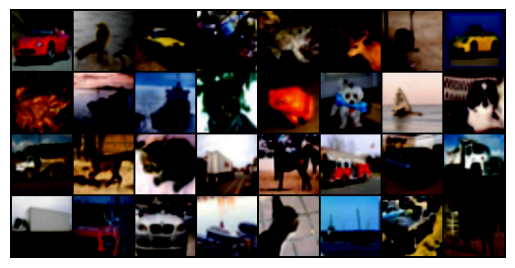

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3/10 
 batch: 100/782 
 loss D: -15.0709810256958 loss G: 162.19091796875


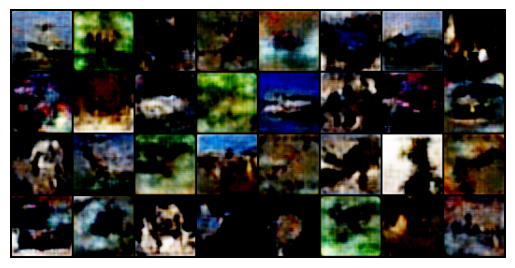

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


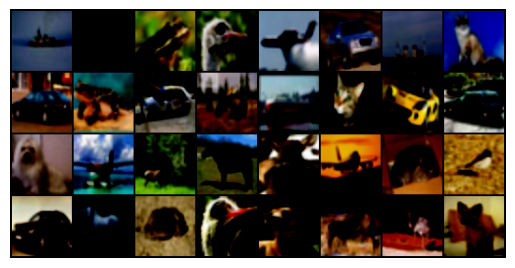

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3/10 
 batch: 200/782 
 loss D: -11.29544448852539 loss G: 153.63018798828125


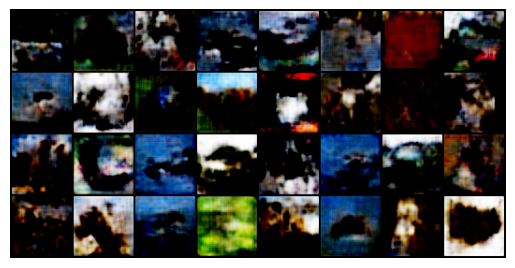

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


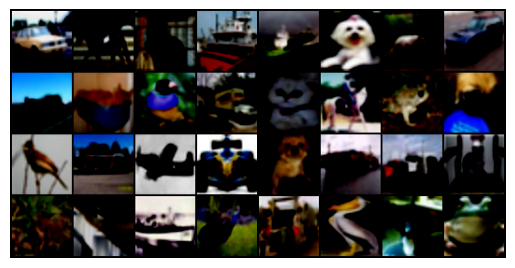

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3/10 
 batch: 300/782 
 loss D: -12.480447769165039 loss G: 160.07025146484375


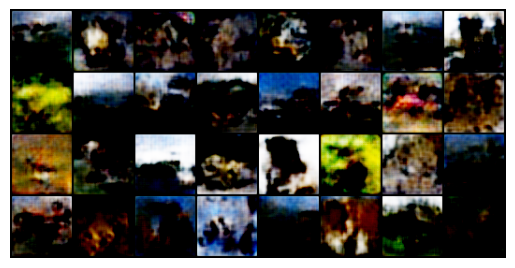

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


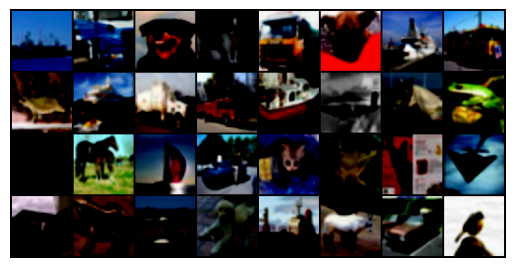

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3/10 
 batch: 400/782 
 loss D: -13.908304214477539 loss G: 154.7815704345703


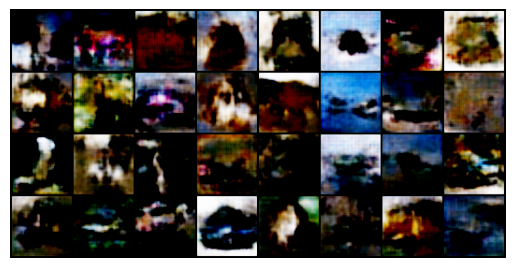

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


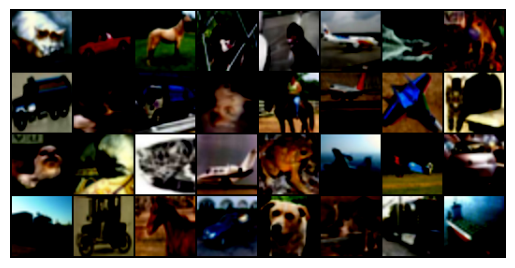

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3/10 
 batch: 500/782 
 loss D: -11.005720138549805 loss G: 161.8274383544922


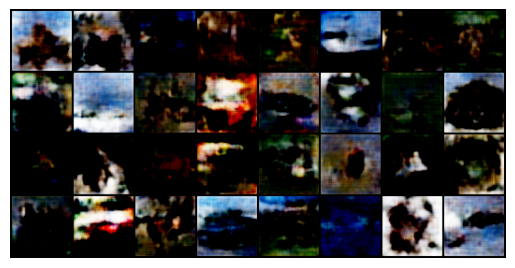

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


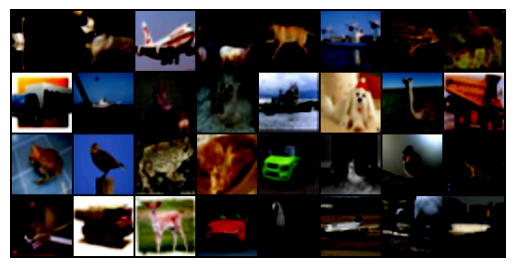

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3/10 
 batch: 600/782 
 loss D: -13.043394088745117 loss G: 159.3829345703125


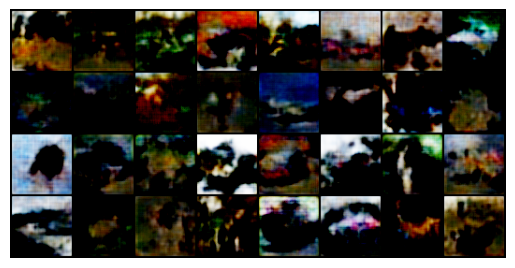

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


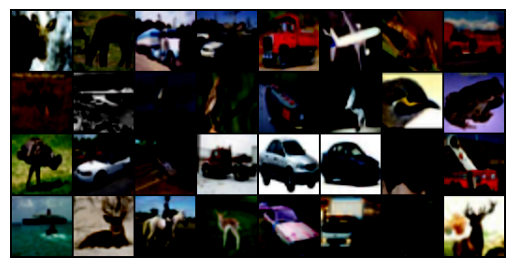

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3/10 
 batch: 700/782 
 loss D: -15.734662055969238 loss G: 166.48922729492188


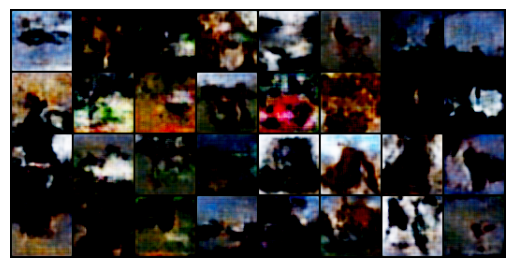

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


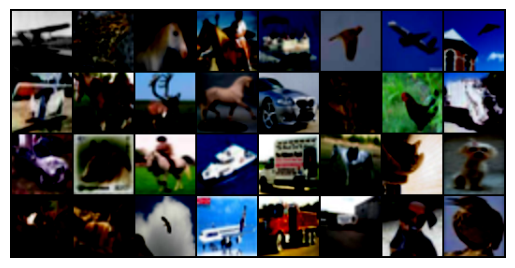

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4/10 
 batch: 0/782 
 loss D: -9.049418449401855 loss G: 152.55123901367188


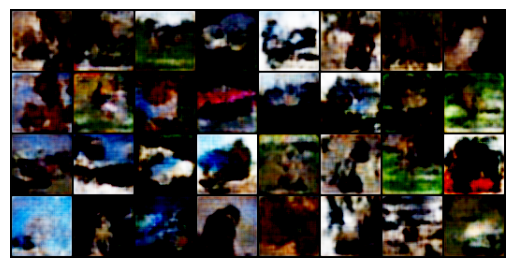

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


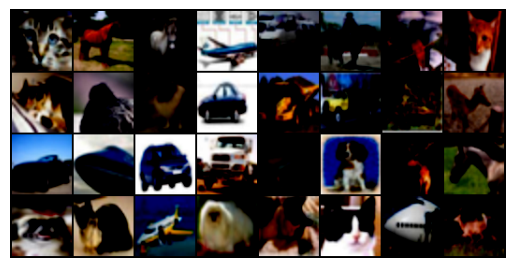

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4/10 
 batch: 100/782 
 loss D: -11.434453010559082 loss G: 160.54600524902344


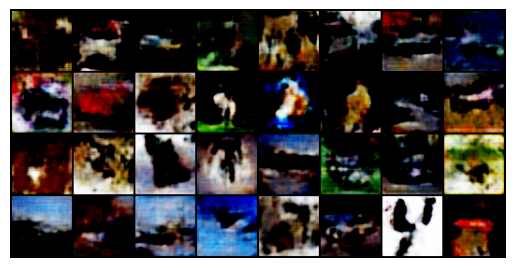

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


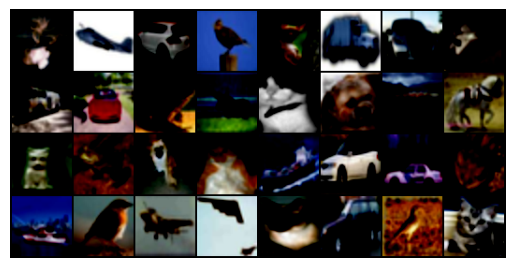

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4/10 
 batch: 200/782 
 loss D: -13.090432167053223 loss G: 159.66256713867188


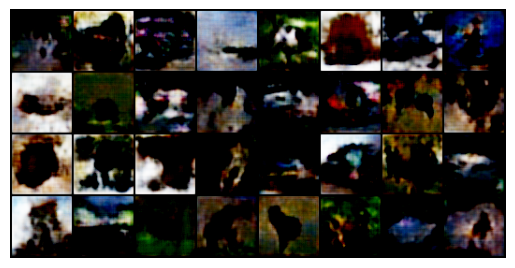

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


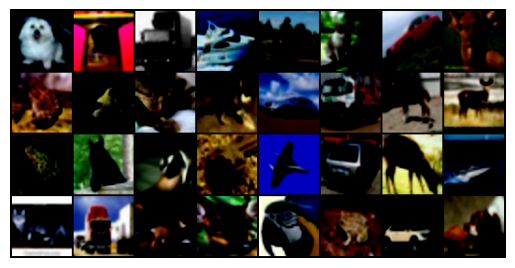

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4/10 
 batch: 300/782 
 loss D: -10.781671524047852 loss G: 164.86376953125


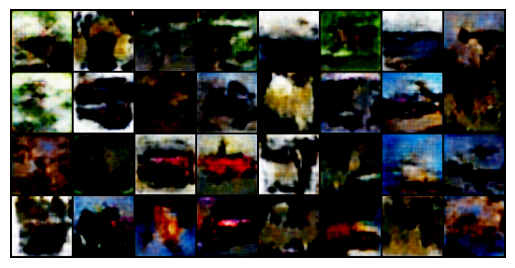

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


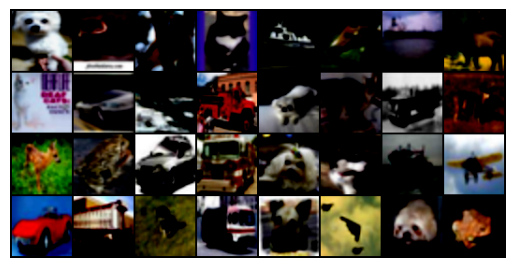

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4/10 
 batch: 400/782 
 loss D: -11.187426567077637 loss G: 163.1416015625


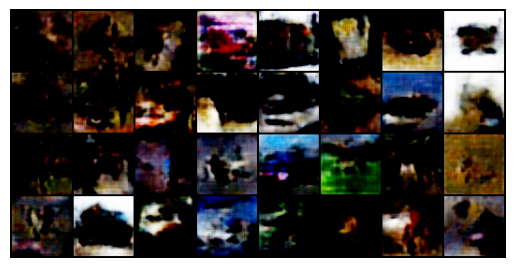

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


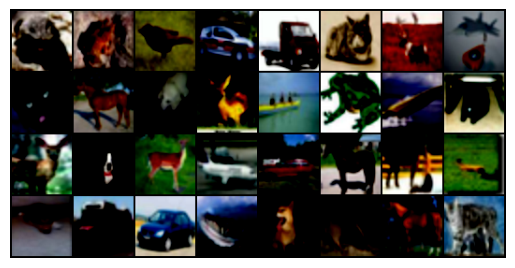

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4/10 
 batch: 500/782 
 loss D: -13.238802909851074 loss G: 162.28285217285156


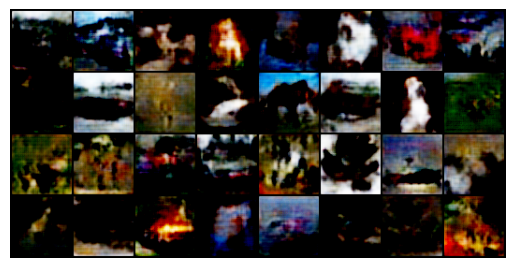

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


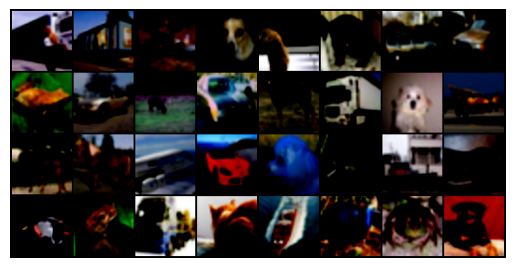

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4/10 
 batch: 600/782 
 loss D: -12.02888298034668 loss G: 154.42071533203125


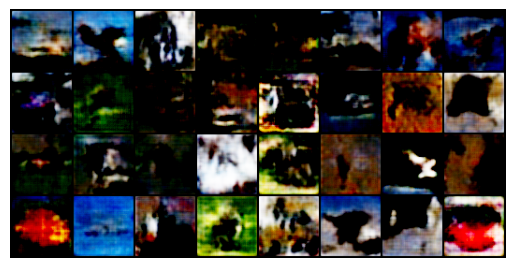

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


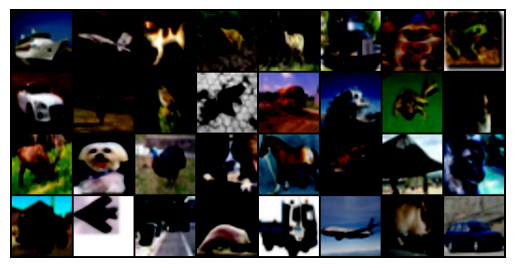

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4/10 
 batch: 700/782 
 loss D: -10.347145080566406 loss G: 167.8271026611328


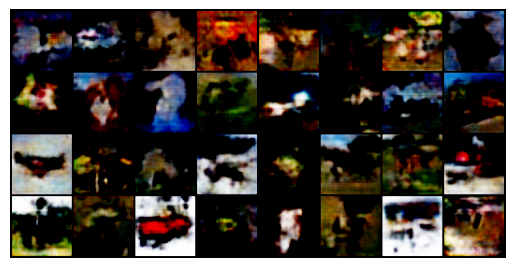

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


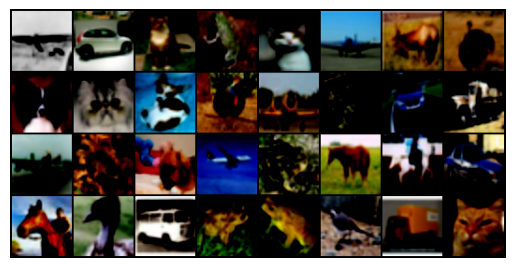

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5/10 
 batch: 0/782 
 loss D: -4.061944007873535 loss G: 161.80087280273438


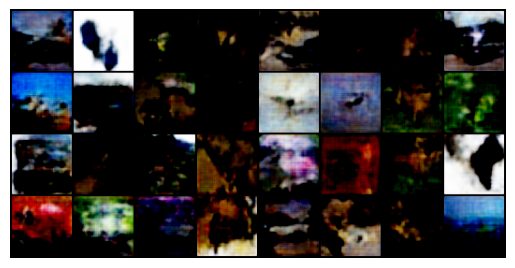

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


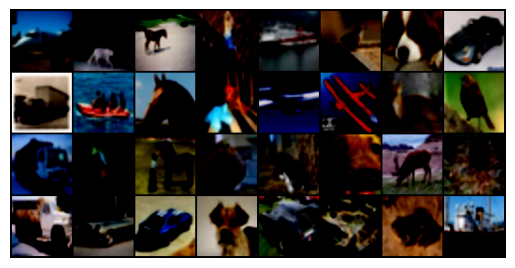

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5/10 
 batch: 100/782 
 loss D: -11.59882640838623 loss G: 163.2236328125


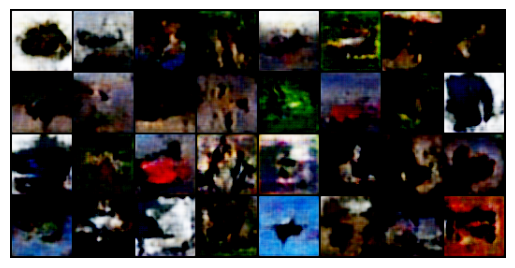

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


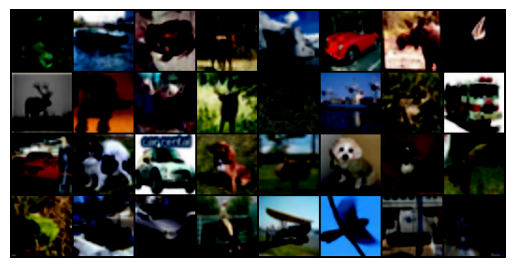

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5/10 
 batch: 200/782 
 loss D: -14.638572692871094 loss G: 160.84854125976562


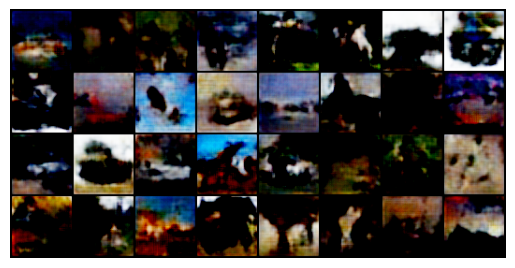

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


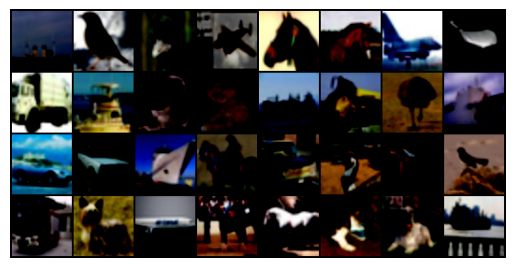

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5/10 
 batch: 300/782 
 loss D: -14.070244789123535 loss G: 150.27056884765625


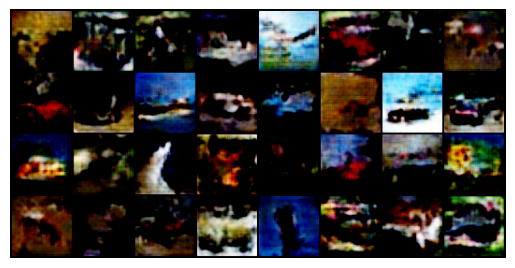

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


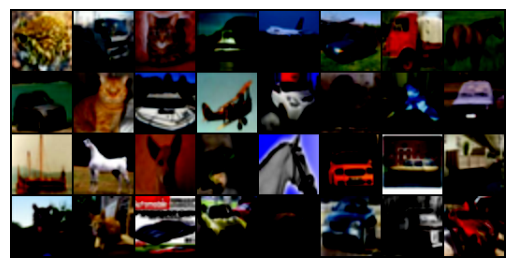

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5/10 
 batch: 400/782 
 loss D: -11.750776290893555 loss G: 175.04150390625


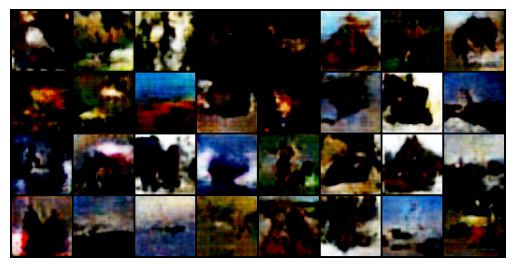

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


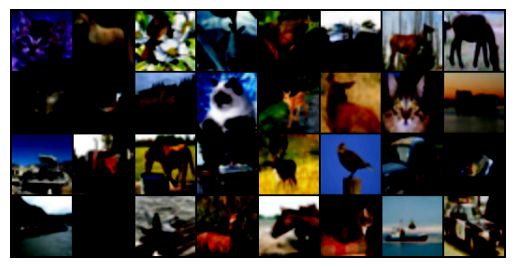

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5/10 
 batch: 500/782 
 loss D: -9.464101791381836 loss G: 158.63934326171875


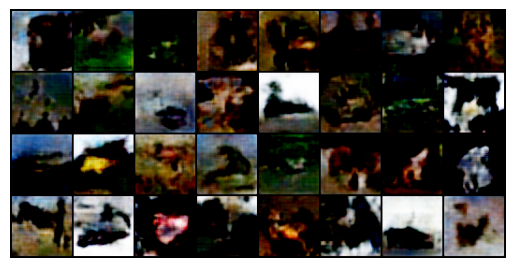

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


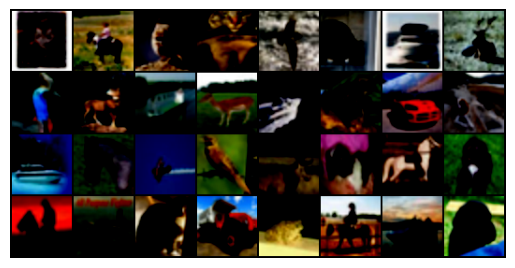

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5/10 
 batch: 600/782 
 loss D: -11.652263641357422 loss G: 147.38458251953125


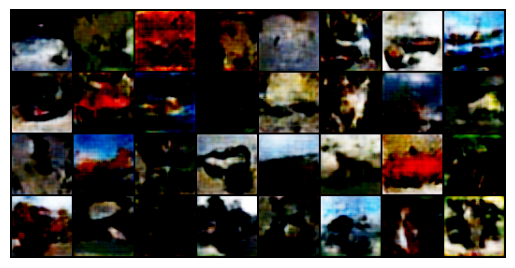

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


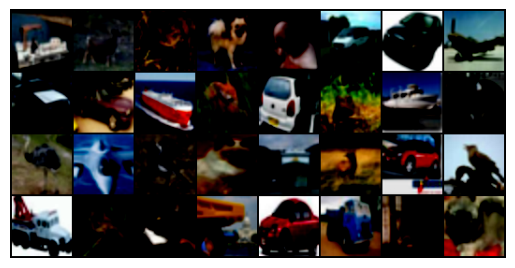

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5/10 
 batch: 700/782 
 loss D: -10.086758613586426 loss G: 181.47579956054688


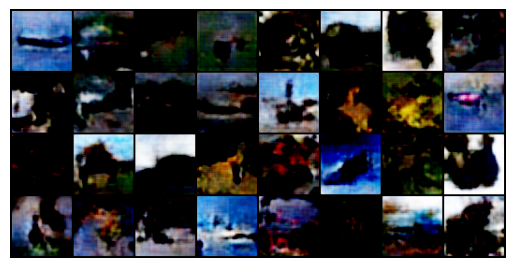

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


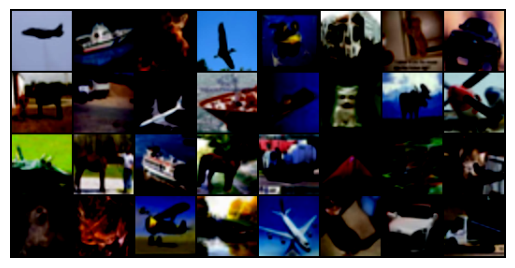

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6/10 
 batch: 0/782 
 loss D: -9.495688438415527 loss G: 157.00425720214844


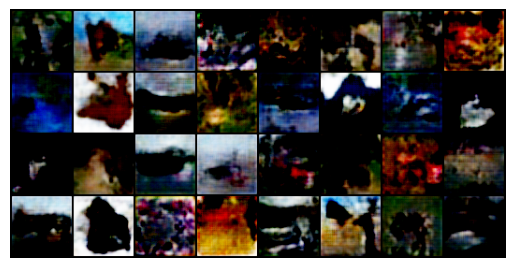

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


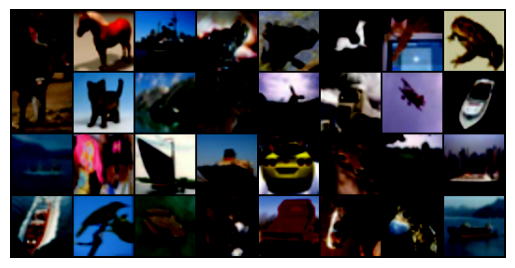

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6/10 
 batch: 100/782 
 loss D: -10.281570434570312 loss G: 150.68035888671875


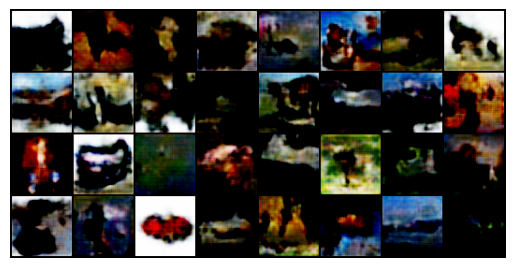

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


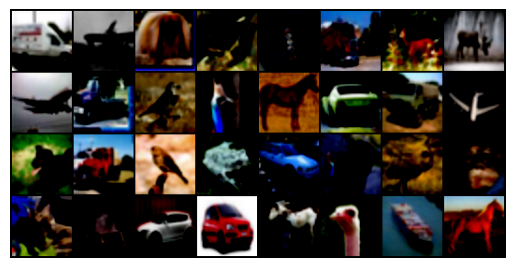

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6/10 
 batch: 200/782 
 loss D: -10.694774627685547 loss G: 164.27166748046875


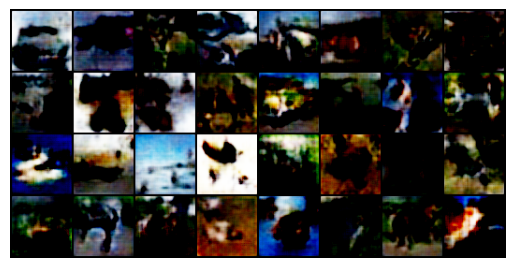

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


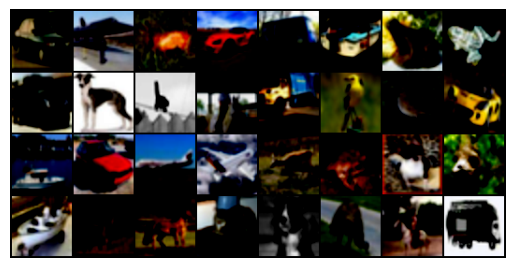

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6/10 
 batch: 300/782 
 loss D: -11.63865852355957 loss G: 156.9222412109375


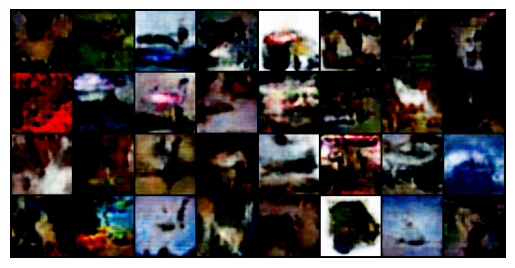

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


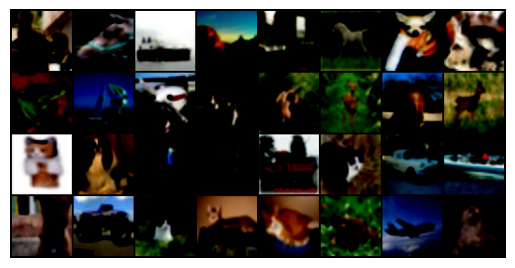

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6/10 
 batch: 400/782 
 loss D: -9.089496612548828 loss G: 156.8980712890625


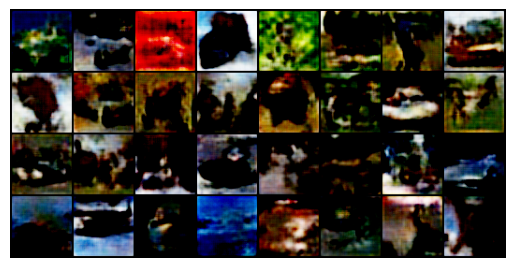

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


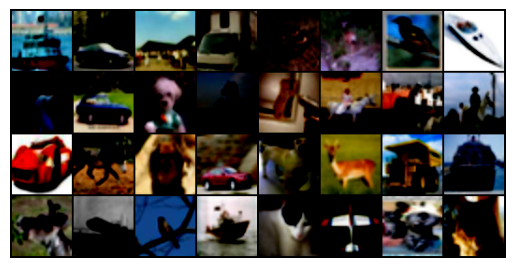

epoch: 6/10 
 batch: 500/782 
 loss D: -12.061666488647461 loss G: 164.7305908203125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


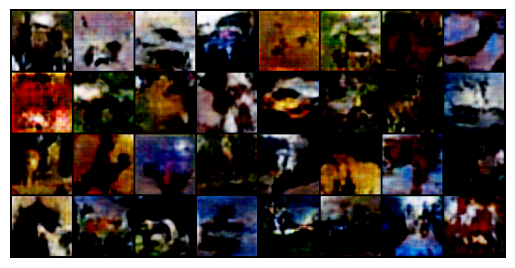

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


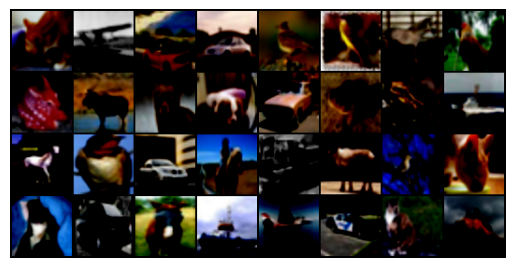

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6/10 
 batch: 600/782 
 loss D: -12.887325286865234 loss G: 164.23338317871094


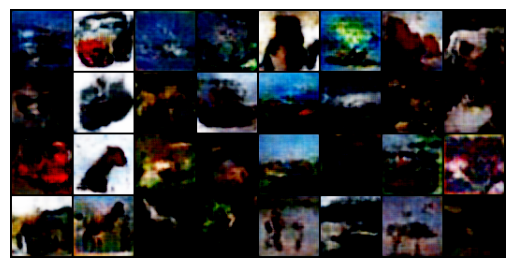

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


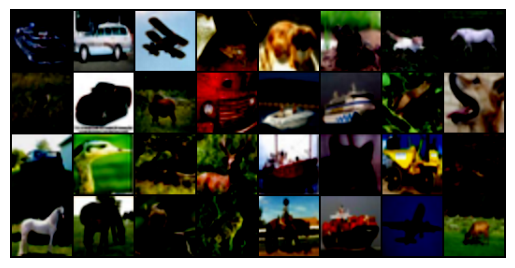

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6/10 
 batch: 700/782 
 loss D: -8.450448989868164 loss G: 166.76046752929688


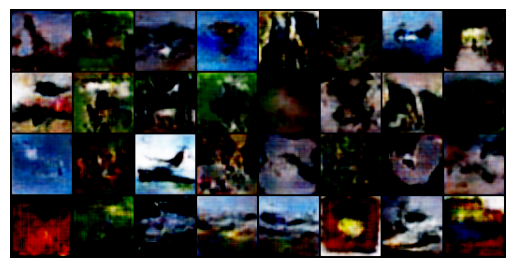

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


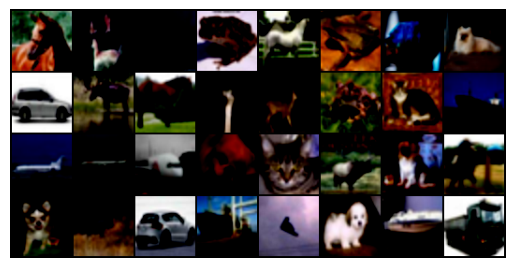

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7/10 
 batch: 0/782 
 loss D: -14.883787155151367 loss G: 154.01943969726562


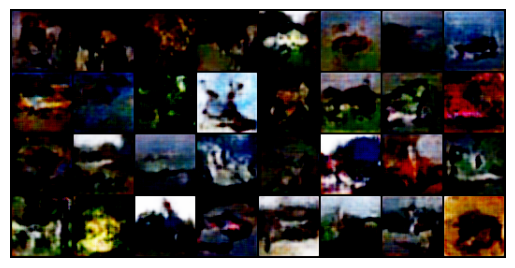

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


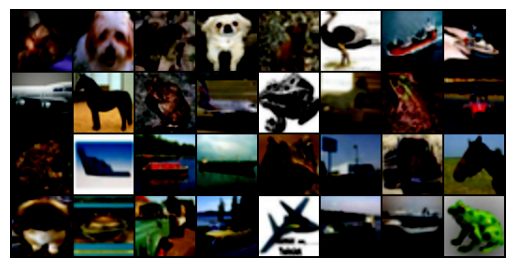

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7/10 
 batch: 100/782 
 loss D: -14.728080749511719 loss G: 155.98858642578125


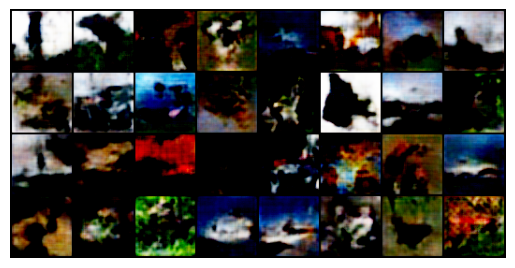

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


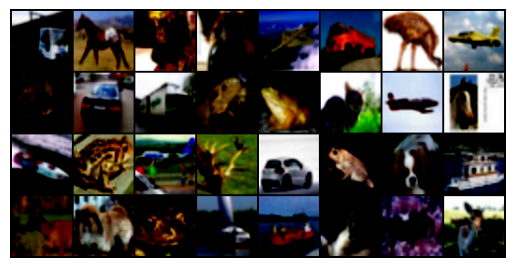

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7/10 
 batch: 200/782 
 loss D: -9.55401611328125 loss G: 164.88394165039062


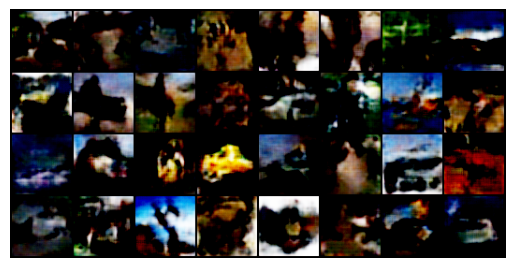

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


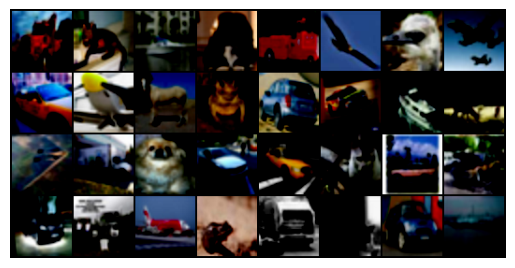

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7/10 
 batch: 300/782 
 loss D: -12.813883781433105 loss G: 153.9955291748047


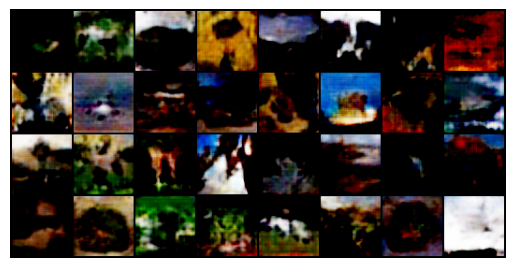

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


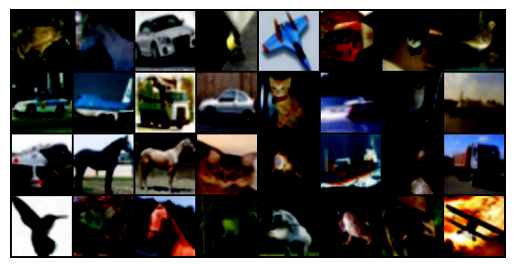

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7/10 
 batch: 400/782 
 loss D: -12.839278221130371 loss G: 147.0970458984375


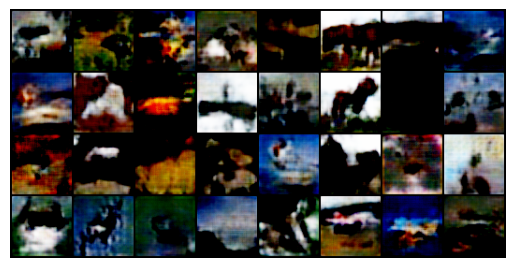

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


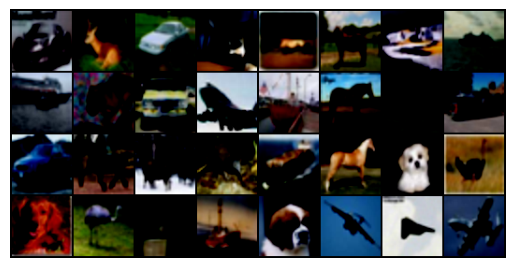

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7/10 
 batch: 500/782 
 loss D: -14.031494140625 loss G: 180.88394165039062


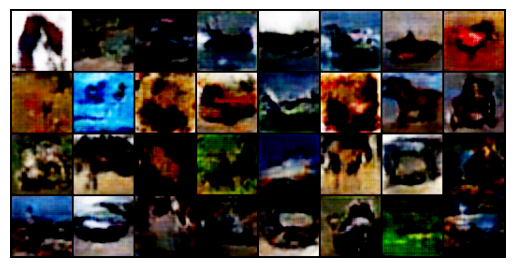

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


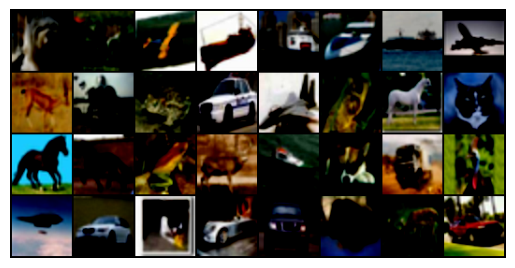

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7/10 
 batch: 600/782 
 loss D: -8.316971778869629 loss G: 140.03994750976562


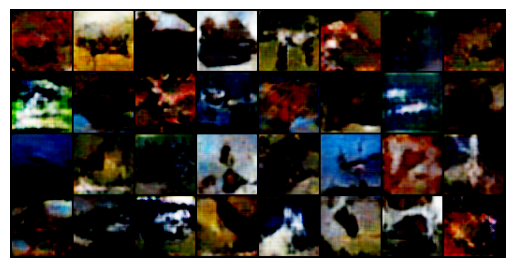

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


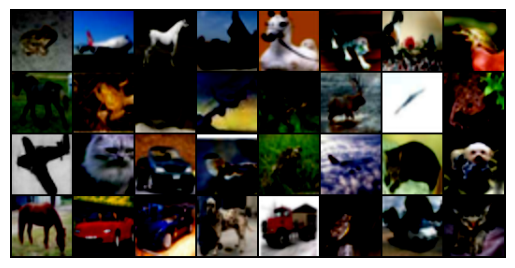

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7/10 
 batch: 700/782 
 loss D: -11.351511001586914 loss G: 149.23281860351562


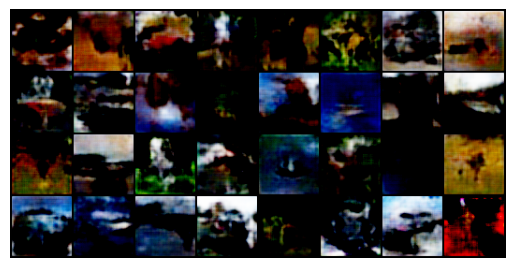

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


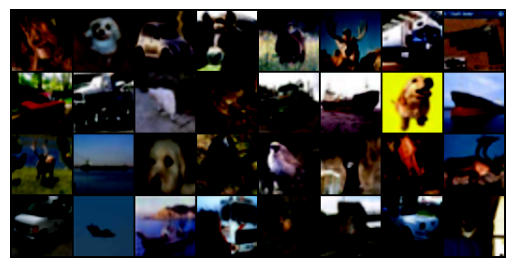

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8/10 
 batch: 0/782 
 loss D: -7.702841758728027 loss G: 145.9000701904297


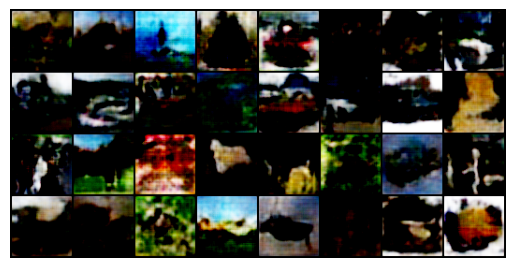

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


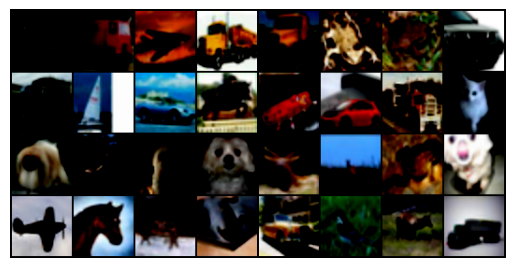

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8/10 
 batch: 100/782 
 loss D: -15.237266540527344 loss G: 127.77522277832031


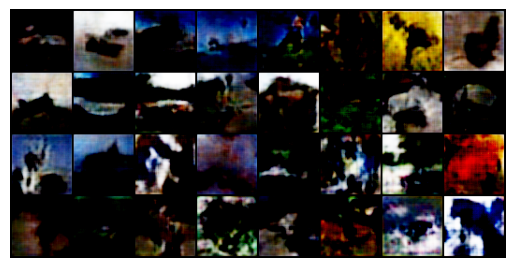

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


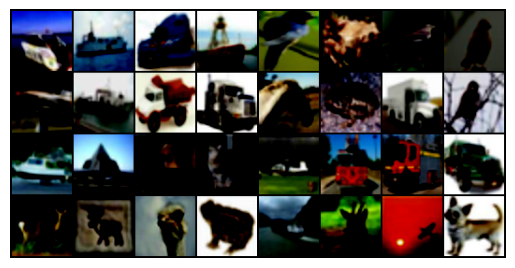

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8/10 
 batch: 200/782 
 loss D: -10.074599266052246 loss G: 163.91534423828125


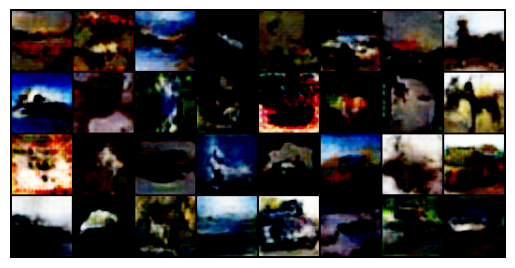

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


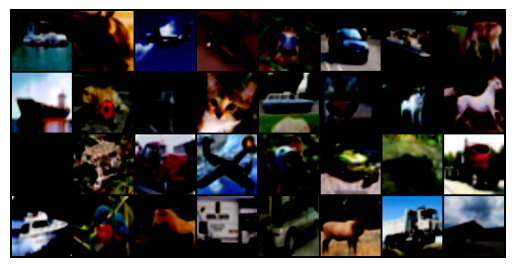

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8/10 
 batch: 300/782 
 loss D: -8.676030158996582 loss G: 155.12518310546875


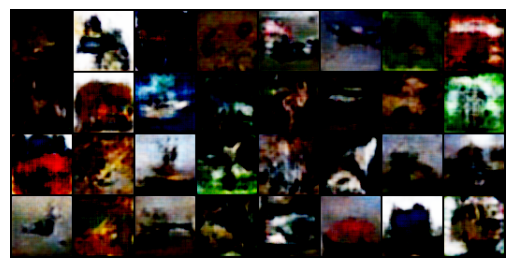

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


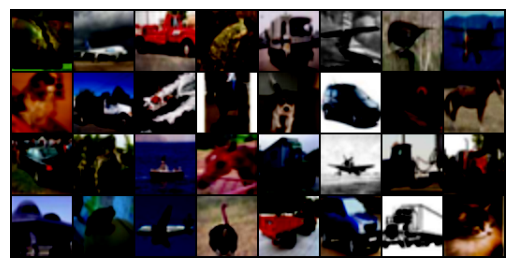

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8/10 
 batch: 400/782 
 loss D: -10.529390335083008 loss G: 149.46261596679688


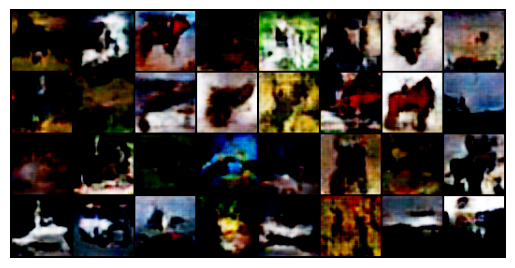

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


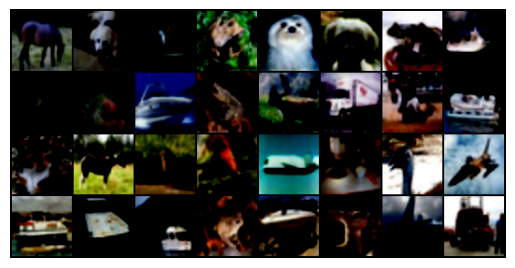

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8/10 
 batch: 500/782 
 loss D: -7.338845252990723 loss G: 150.0166778564453


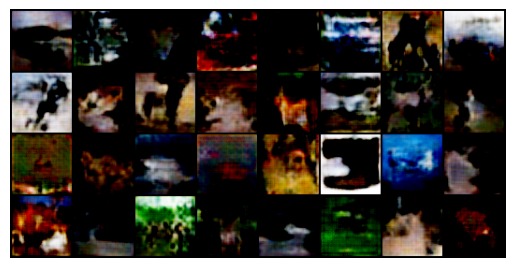

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


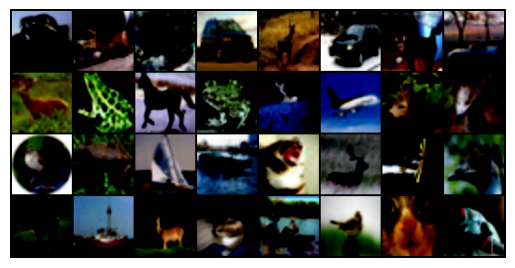

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8/10 
 batch: 600/782 
 loss D: -11.158117294311523 loss G: 155.55136108398438


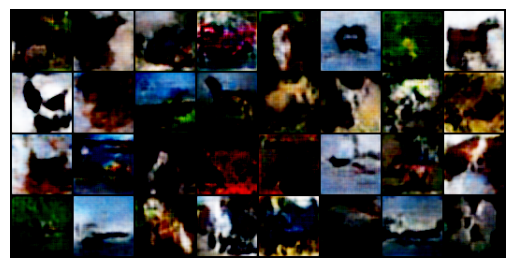

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


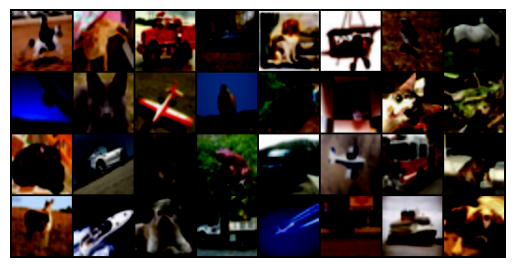

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8/10 
 batch: 700/782 
 loss D: -11.442131042480469 loss G: 148.87820434570312


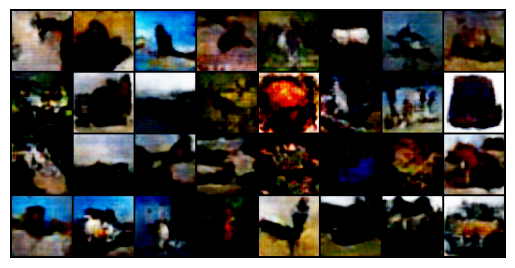

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


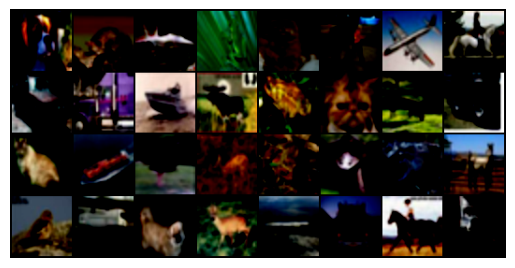

  0%|          | 0/782 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9/10 
 batch: 0/782 
 loss D: -11.182268142700195 loss G: 156.39956665039062


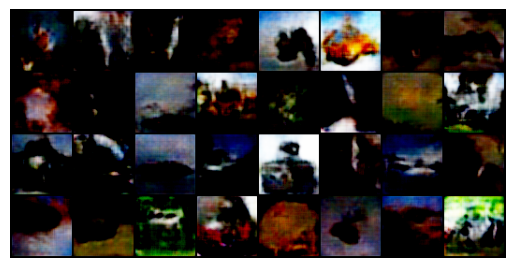

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


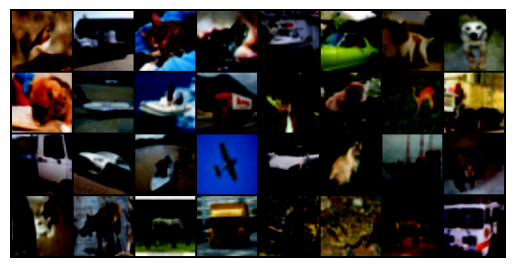

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9/10 
 batch: 100/782 
 loss D: -12.354545593261719 loss G: 147.69671630859375


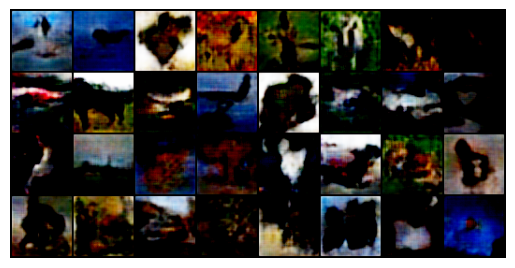

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


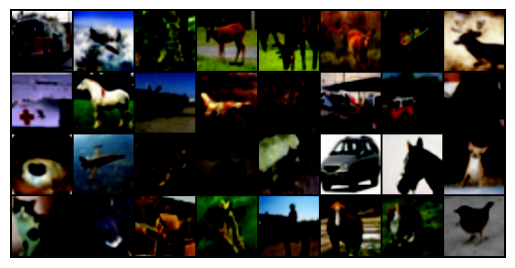

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9/10 
 batch: 200/782 
 loss D: -8.329378128051758 loss G: 154.08888244628906


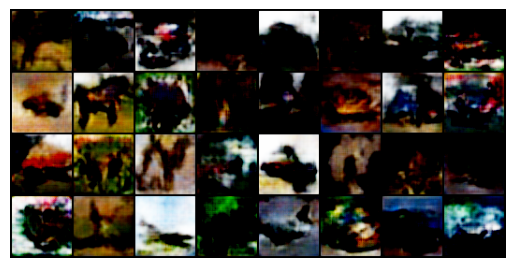

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


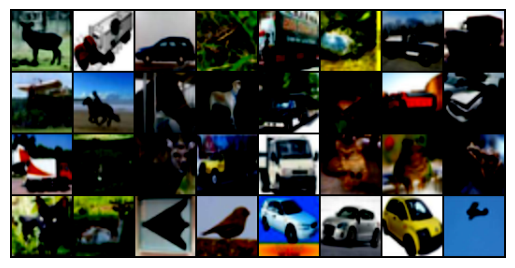

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9/10 
 batch: 300/782 
 loss D: -16.646455764770508 loss G: 142.389892578125


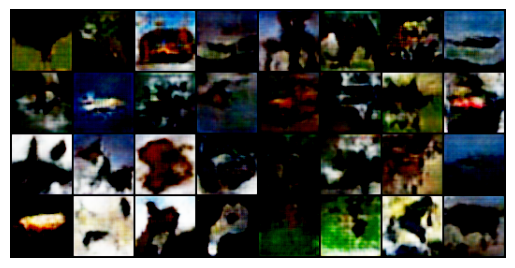

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


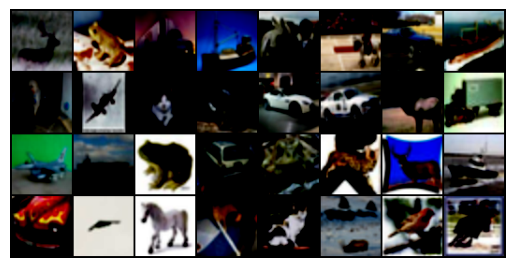

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9/10 
 batch: 400/782 
 loss D: -19.671030044555664 loss G: 147.62307739257812


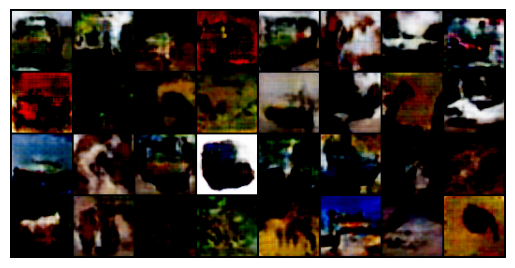

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


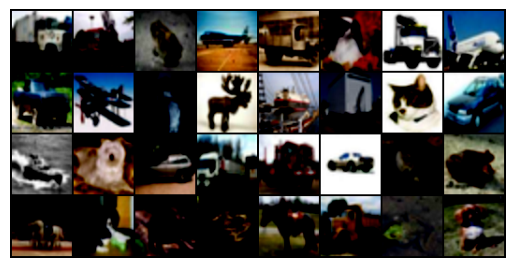

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9/10 
 batch: 500/782 
 loss D: -15.714478492736816 loss G: 139.27859497070312


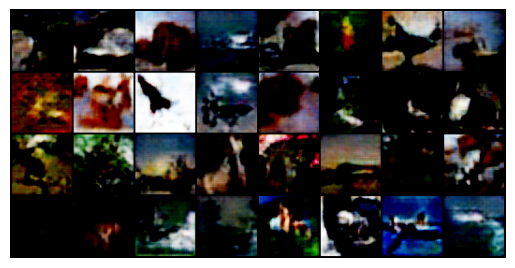

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


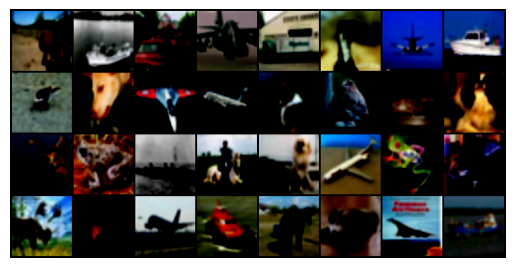

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9/10 
 batch: 600/782 
 loss D: -8.419700622558594 loss G: 137.9265594482422


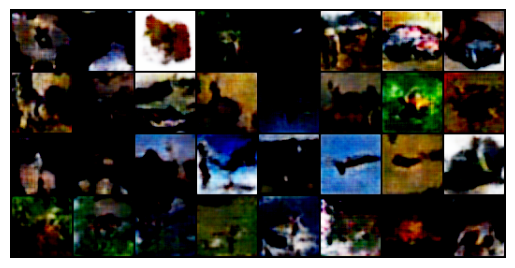

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


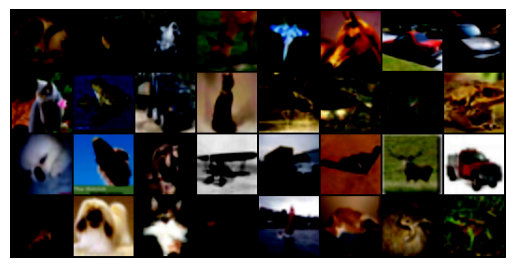

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9/10 
 batch: 700/782 
 loss D: -9.803845405578613 loss G: 144.88421630859375


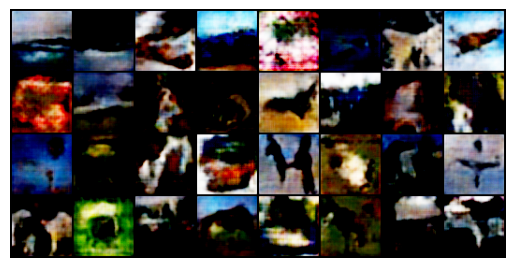

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


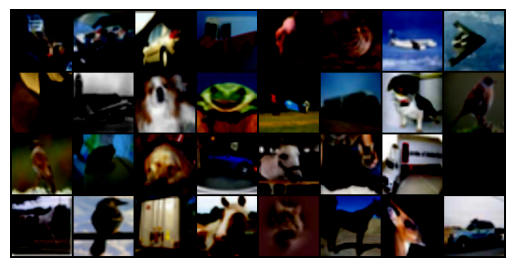

In [26]:
for epoch in tqdm(range(num_epochs)):
    for batch_idx, (real, labels) in enumerate(tqdm(loader)):
        real = real.to(device)
        labels = labels.to(device)
        cur_batch_size = real.shape[0]

        for _ in range(critic_iterations):
            noise = torch.randn(cur_batch_size, z_dim, 1, 1).to(device)
            fake = gen(noise, labels)
            critic_real = disc(real, labels).reshape(-1)
            critic_fake = disc(fake, labels).reshape(-1)
            gp = gradient_penalty(disc, labels, real, fake, device)
            loss_critic = -(torch.mean(critic_real) - torch.mean(critic_fake)) + lambda_gp * gp
            
            opt_disc.zero_grad()
            loss_critic.backward(retain_graph=True)
            opt_disc.step()

        output = disc(fake, labels).reshape(-1)
        loss_gen = -torch.mean(output)
        opt_gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        if batch_idx % 100 == 0:
            print(f"epoch: {epoch}/{num_epochs} \n batch: {batch_idx}/{len(loader)} \n loss D: {loss_critic} loss G: {loss_gen}")

            with torch.no_grad():
                fake = gen(noise, labels)
                fake_flattened = fake.detach().cpu().view(-1, 3, 64, 64)
                fake_grid = torchvision.utils.make_grid(fake_flattened[:32], nrow=8)
                plt.imshow(fake_grid.permute(1, 2, 0).squeeze())
                plt.axis('off')
                plt.show()
                real_unflatten = real.detach().cpu().view(-1, 3, 64, 64)
                real_grid = torchvision.utils.make_grid(real_unflatten[:32], nrow=8)
                plt.imshow(real_grid.permute(1, 2, 0).squeeze())
                plt.axis('off')
                plt.show()